The results are cached and the training can be resumed if not deleted.

In [2]:
# !rm -rf ~/ray_results/PPO ~/ray_results/

In [3]:
# !pip install --upgrade ray[default,rllib,tune,serve] optuna ta

In [4]:
from trade_flow.adapters.cdd import CryptoDataDownload

import pandas as pd
import numpy as np

def prepare_data(df):
    df['volume'] = np.int64(df['volume'])
    df['date'] = pd.to_datetime(df['date'])
    df.sort_values(by='date', ascending=True, inplace=True)
    df.reset_index(drop=True, inplace=True)
    df['date'] = df['date'].dt.strftime('%Y-%m-%d %I:%M %p')
    return df

def fetch_data():
    cdd = CryptoDataDownload()
    bitfinex_data = cdd.fetch("Bitfinex", "USD", "BTC", "1h")
    bitfinex_data = bitfinex_data[['date', 'open', 'high', 'low', 'close', 'volume']]
    bitfinex_data = prepare_data(bitfinex_data)
    return bitfinex_data

def load_csv(filename):
    df = pd.read_csv('data/' + filename, skiprows=1)
    df.drop(columns=['symbol', 'volume_btc'], inplace=True)

    # Fix timestamp from "2019-10-17 09-AM" to "2019-10-17 09-00-00 AM"
    df['date'] = df['date'].str[:14] + '00-00 ' + df['date'].str[-2:]

    return prepare_data(df)

In [5]:
import ta

def rsi(price: 'pd.Series[pd.Float64Dtype]', period: float) -> 'pd.Series[pd.Float64Dtype]':
    r = price.diff()
    upside = np.minimum(r, 0).abs()
    downside = np.maximum(r, 0).abs()
    rs = upside.ewm(alpha=1 / period).mean() / downside.ewm(alpha=1 / period).mean()
    return 100*(1 - (1 + rs) ** -1)

def macd(price: 'pd.Series[pd.Float64Dtype]', fast: float, slow: float, signal: float) -> 'pd.Series[pd.Float64Dtype]':
    fm = price.ewm(span=fast, adjust=False).mean()
    sm = price.ewm(span=slow, adjust=False).mean()
    md = fm - sm
    signal = md - md.ewm(span=signal, adjust=False).mean()
    return signal

def generate_features(data):
    # Naming convention across most technical indicator libraries
    data = data.rename(columns={'date': 'Date', 
                                'open': 'Open', 
                                'high': 'High', 
                                'low': 'Low', 
                                'close': 'Close', 
                                'volume': 'Volume'})
    data = data.set_index('Date')

    # Custom indicators
    features = pd.DataFrame.from_dict({
        'dfast': df['Close'].rolling(window=10).std().abs(),
        'dmedium': df['Close'].rolling(window=50).std().abs(),
        'dslow': df['Close'].rolling(window=100).std().abs(),
        'fast': df['Close'].rolling(window=10).mean(),
        'medium': df['Close'].rolling(window=50).mean(),
        'slow': df['Close'].rolling(window=100).mean(),
        'ema_fast': ta.trend.ema_indicator(df['Close'], window=5, fillna=True),
        'ema_medium': ta.trend.ema_indicator(df['Close'], window=10, fillna=True),
        'ema_slow': ta.trend.ema_indicator(df['Close'], window=64, fillna=True),
        'lr': np.log(df['Close']).diff().fillna(0),
        'rsi_5': rsi(df['Close'], period=5),
        'rsi_10': rsi(df['Close'], period=10),
        'rsi_100': rsi(df['Close'], period=100),
        'rsi_7': rsi(df['Close'], period=7),
        'rsi_14': rsi(df['Close'], period=14),
        'rsi_28': rsi(df['Close'], period=28),
        'macd_normal': macd(df['Close'], fast=12, slow=26, signal=9),
        'macd_short': macd(df['Close'], fast=10, slow=50, signal=5),
        'macd_long': macd(df['Close'], fast=200, slow=100, signal=50),
    })

    # Generate all default indicators from ta library
    df = ta.add_all_ta_features(data, 'Open', 'High', 'Low', 'Close', 'Volume', fillna=True)

    # Concatenate both manually and automatically generated features
    data = pd.concat([df, features], axis='columns').fillna(method='pad')

    # Remove potential column duplicates
    data = data.loc[:,~data.columns.duplicated()]

    # Revert naming convention
    data = data.rename(columns={'Date': 'date', 
                                'Open': 'open', 
                                'High': 'high', 
                                'Low': 'low', 
                                'Close': 'close', 
                                'Volume': 'volume'})

    # A lot of indicators generate NaNs at the beginning of DataFrames, so remove them
    data = data.iloc[200:]
    data = data.reset_index(drop=True)

    return data

In [6]:
from sklearn.model_selection import train_test_split

def split_data(data):
    X = data.copy()
    y = X['close'].pct_change()

    X_train_test, X_valid, y_train_test, y_valid = \
        train_test_split(data, data['close'].pct_change(), train_size=0.67, test_size=0.33, shuffle=False)

    X_train, X_test, y_train, y_test = \
        train_test_split(X_train_test, y_train_test, train_size=0.50, test_size=0.50, shuffle=False)

    return X_train, X_test, X_valid, y_train, y_test, y_valid

In [7]:
data = fetch_data()
data

,date,open,high,low,close,volume
0,2018-05-15 06:00 AM,8723.800000,8793.0,8714.900000,8739.0,8988053
1,2018-05-15 07:00 AM,8739.000000,8754.8,8719.300000,8743.0,2288904
2,2018-05-15 08:00 AM,8743.000000,8743.1,8653.200000,8723.7,8891773
3,2018-05-15 09:00 AM,8723.700000,8737.8,8701.200000,8708.1,2054868
4,2018-05-15 10:00 AM,8708.100000,8855.7,8695.800000,8784.4,17309722
...,...,...,...,...,...,...
32601,2022-02-01 08:00 PM,38410.715291,38760.0,38407.820285,38529.0,2192886
32602,2022-02-01 09:00 PM,38532.000000,38850.0,38521.000000,38809.0,9653013
32603,2022-02-01 10:00 PM,38804.000000,38876.0,38573.000000,38713.0,1955713
32604,2022-02-01 11:00 PM,38709.059135,38900.0,38630.000000,38713.0,1372515


In [8]:
#dataset = generate_features(data)
dataset = data.copy()
dataset

,date,open,high,low,close,volume
0,2018-05-15 06:00 AM,8723.800000,8793.0,8714.900000,8739.0,8988053
1,2018-05-15 07:00 AM,8739.000000,8754.8,8719.300000,8743.0,2288904
2,2018-05-15 08:00 AM,8743.000000,8743.1,8653.200000,8723.7,8891773
3,2018-05-15 09:00 AM,8723.700000,8737.8,8701.200000,8708.1,2054868
4,2018-05-15 10:00 AM,8708.100000,8855.7,8695.800000,8784.4,17309722
...,...,...,...,...,...,...
32601,2022-02-01 08:00 PM,38410.715291,38760.0,38407.820285,38529.0,2192886
32602,2022-02-01 09:00 PM,38532.000000,38850.0,38521.000000,38809.0,9653013
32603,2022-02-01 10:00 PM,38804.000000,38876.0,38573.000000,38713.0,1955713
32604,2022-02-01 11:00 PM,38709.059135,38900.0,38630.000000,38713.0,1372515


In [9]:
X_train, X_test, X_valid, y_train, y_test, y_valid = \
    split_data(data)

import os
cwd = os.getcwd()
train_csv = os.path.join(cwd, 'train.csv')
test_csv = os.path.join(cwd, 'test.csv')
valid_csv = os.path.join(cwd, 'valid.csv')
X_train.to_csv(train_csv, index=False)
X_test.to_csv(test_csv, index=False)
X_valid.to_csv(valid_csv, index=False)

In [10]:
# Things to understand here:
# Writing a Renderer

import matplotlib.pyplot as plt

from trade_flow.environments.generic import Renderer


class PositionChangeChart(Renderer):
    def __init__(self, color: str = "orange"):
        self.color = "orange"

    def render(self, env, **kwargs):
        history = pd.DataFrame(env.observer.renderer_history)

        actions = list(history.action)
        price = list(history.close)

        buy = {}
        sell = {}

        for i in range(len(actions) - 1):
            a1 = actions[i]
            a2 = actions[i + 1]

            if a1 != a2:
                if a1 == 0 and a2 == 1:
                    buy[i] = price[i]
                else:
                    sell[i] = price[i]

        buy = pd.Series(buy)
        sell = pd.Series(sell)

        fig, axs = plt.subplots(1, 2, figsize=(15, 5))

        fig.suptitle("Performance")

        axs[0].plot(np.arange(len(price)), price, label="price", color=self.color)
        axs[0].scatter(buy.index, buy.values, marker="^", color="green")
        axs[0].scatter(sell.index, sell.values, marker="^", color="red")
        axs[0].set_title("Trading Chart")

        performance_df = pd.DataFrame().from_dict(env.action_scheme.portfolio.performance, orient='index')
        performance_df.plot(ax=axs[1])
        axs[1].set_title("Net Worth")

        plt.show()

In [11]:
# Things to understand here:
# execution_order
# Types of execution logic
# Exchange
# DataFeed
# renderer_feed
# default (env)

import ray
import numpy as np
import pandas as pd

from ray import tune
from ray.tune.registry import register_env

import trade_flow.environments.default as default

from trade_flow.environments.default.rewards import PBR, RiskAdjustedReturns
from trade_flow.environments.default.rewards import SimpleProfit
from trade_flow.environments.default.actions import BSH, ManagedRiskOrders
from trade_flow.feed.core import DataFeed, Stream
from trade_flow.feed.core.base import NameSpace
from trade_flow.oms.exchanges import Exchange, ExchangeOptions
from trade_flow.oms.instruments import USD, BTC
from trade_flow.oms.services.execution.simulated import execute_order
from trade_flow.oms.wallets import Wallet, Portfolio

def create_env(config):
    data = pd.read_csv(filepath_or_buffer=config["csv_filename"], 
                       parse_dates=['date']).fillna(
                           method='backfill').fillna(method='ffill')

    # TODO: adjust according to your commission percentage, if present
    commission = 0.001
    price = Stream.source(list(data["close"]), 
                          dtype="float").rename("USD-BTC")
    bitstamp_options = ExchangeOptions(commission=commission)
    bitstamp = Exchange("bitstamp", 
                        service=execute_order, 
                        options=bitstamp_options)(price)

    cash = Wallet(bitstamp, 100000 * USD)
    asset = Wallet(bitstamp, 0 * BTC)

    portfolio = Portfolio(USD, [cash, asset])

    # Custom indicators
    features = pd.DataFrame.from_dict({
        'dfast': data['close'].rolling(window=10).std().abs(),
        'dmedium': data['close'].rolling(window=50).std().abs(),
        'dslow': data['close'].rolling(window=100).std().abs(),
        'fast': data['close'].rolling(window=10).mean(),
        'medium': data['close'].rolling(window=50).mean(),
        'slow': data['close'].rolling(window=100).mean(),
        'ema_fast': ta.trend.ema_indicator(data['close'], window=5, fillna=True),
        'ema_medium': ta.trend.ema_indicator(data['close'], window=10, fillna=True),
        'ema_slow': ta.trend.ema_indicator(data['close'], window=64, fillna=True),
        'lr': np.log(data['close']).diff().fillna(0),
        'rsi_5': rsi(data['close'], period=5),
        'rsi_10': rsi(data['close'], period=10),
        'rsi_100': rsi(data['close'], period=100),
        'rsi_7': rsi(data['close'], period=7),
        'rsi_14': rsi(data['close'], period=14),
        'rsi_28': rsi(data['close'], period=28),
        'macd_normal': macd(data['close'], fast=12, slow=26, signal=9),
        'macd_short': macd(data['close'], fast=10, slow=50, signal=5),
        'macd_long': macd(data['close'], fast=200, slow=100, signal=50),
    })

    ta.add_all_ta_features(data, 
                           'open', 
                           'high', 
                           'low', 
                           'close', 
                           'volume', 
                           fillna=True)

    with NameSpace("bitstamp"):
        data = pd.concat([data, features], axis='columns')
        automatic_features = [
            Stream.source(list(data[c]), 
                          dtype="float").rename(c) for c in data.columns[1:]
        ]

    feed = DataFeed(automatic_features)
    feed.compile()

    reward_scheme = PBR(price=price)

    action_scheme = BSH(
        cash=cash,
        asset=asset
    ).attach(reward_scheme)

    renderer_feed = DataFeed([
        Stream.source(list(data["date"])).rename("date"),
        Stream.source(list(data["open"]), dtype="float").rename("open"),
        Stream.source(list(data["high"]), dtype="float").rename("high"),
        Stream.source(list(data["low"]), dtype="float").rename("low"),
        Stream.source(list(data["close"]), dtype="float").rename("close"), 
        Stream.source(list(data["volume"]), dtype="float").rename("volume"), 
        Stream.sensor(action_scheme, 
                      lambda s: s.action, dtype="float").rename("action")
    ])

    environment = default.create(
        feed=feed,
        portfolio=portfolio,
        action_scheme=action_scheme,
        reward_scheme=reward_scheme,
        renderer_feed=renderer_feed,
        renderer=[
            PositionChangeChart(),
            default.renderers.PlotlyTradingChart(),
        ],
        window_size=config["window_size"],
        max_allowed_loss=0.9
    )
    return environment

ray.init(num_cpus=6,
         include_dashboard=True,
         address=None,  # set `address=None` to train on laptop
         ignore_reinit_error=True)

register_env("TradingEnvironment", create_env)

2022-02-02 14:51:17,753	INFO services.py:1340 -- View the Ray dashboard at http://127.0.0.1:8265


In [12]:
from ray.tune.schedulers import ASHAScheduler
from ray.tune.suggest import ConcurrencyLimiter
from ray.tune.suggest.optuna import OptunaSearch

LR = tune.loguniform(1e-5, 1e-2)
GAMMA = tune.uniform(0.8, 0.9999)
LAMBDA = tune.uniform(0.1, 0.8)
VF_LOSS_COEFF = tune.uniform(0.01, 1.0)
ENTROPY_COEFF = tune.uniform(1e-8, 1e-1)

checkpoint_metric = 'episode_reward_mean'

# Specific configuration keys that will be used during training
env_config_training = {
    "window_size": 14,  # The number of past samples to look at (hours)
    "reward_window_size": 7,  # And calculate reward based on the actions taken in the next n hours
    "max_allowed_loss": 0.10,  # If it goes past 90% loss during the iteration, we don't want to waste time on a "loser".
    "csv_filename": train_csv  # The variable that will be used to differentiate training and validation datasets
}
# Specific configuration keys that will be used during evaluation (only the overridden ones)
env_config_evaluation = {
    "max_allowed_loss": 1.00,  # During validation runs we want to see how bad it would go. Even up to 100% loss.
    "csv_filename": test_csv,  # The variable that will be used to differentiate training and validation datasets
}

search_alg = OptunaSearch()
search_alg = ConcurrencyLimiter(search_alg, max_concurrent=4)

scheduler = ASHAScheduler()

import time
start = time.time()
analysis = tune.run(
    "PPO",
    stop={
        "episode_reward_mean": 5000,
        "training_iteration": 35,
    },
    config={
        "env": "TradingEnvironment",
        "env_config": env_config_training,
        "log_level": "ERROR",
        #"log_level": "INFO",
        #"log_level": "DEBUG",
        "framework": "torch",
        "ignore_worker_failures": True,
        "num_workers": 2,
        "num_gpus": 0,
        "clip_rewards": True,
        "lr": LR,
        "lr_schedule": [
            [0, 1e-1],
            [int(1e2), 1e-2],
            [int(1e3), 1e-3],
            [int(1e4), 1e-4],
            [int(1e5), 1e-5],
            [int(1e6), 1e-6],
            [int(1e7), 1e-7]
        ],
        "model": {
            "use_lstm": True,
            "lstm_cell_size": 512
        },
        "gamma": GAMMA,
        "observation_filter": "MeanStdFilter",
        "lambda": LAMBDA,
        "vf_share_layers": True,
        "vf_loss_coeff": VF_LOSS_COEFF,
        "entropy_coeff": ENTROPY_COEFF,
        "evaluation_interval": 1,  # Run evaluation on every iteration
        "evaluation_config": {
            "env_config": env_config_evaluation,  # The dictionary we built before (only the overriding keys to use in evaluation)
            "explore": False,  # We don't want to explore during evaluation. All actions have to be repeatable.
        },
    },
    metric=checkpoint_metric,
    mode="max",
    search_alg=search_alg,
    scheduler=scheduler,
    num_samples=10,  # Samples per hyperparameter combination. More averages out randomness. Less runs faster
    #resources_per_trial={"cpu": 2},
    keep_checkpoints_num=10,  # Keep the last 10 checkpoints
    checkpoint_freq=1,  # Do a checkpoint on each iteration (slower but you can pick more finely the checkpoint to use later)
    resume="AUTO",
)
taken = time.time() - start
print(f"Time taken: {taken:.2f} seconds.")
print(f"Best config: {analysis.best_config}")

[I 2022-02-02 14:51:22,858] A new study created in memory with name: optuna
2022-02-02 14:51:25,269	INFO trial_runner.py:519 -- No local checkpoint was found. Ray Tune will now start a new experiment.


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,PENDING,,0.0172487,0.97468,0.675254,0.000328334,0.201957


(PPO pid=7301) 2022-02-02 14:51:46,411	INFO ppo.py:167 -- In multi-agent mode, policies will be optimized sequentially by the multi-GPU optimizer. Consider setting simple_optimizer=True if this doesn't work for you.
(PPO pid=7301) 2022-02-02 14:51:46,411	INFO trainer.py:745 -- Current log_level is ERROR. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7302) 2022-02-02 14:51:47,556	INFO ppo.py:167 -- In multi-agent mode, policies will be optimized sequentially by the multi-GPU optimizer. Consider setting simple_optimizer=True if this doesn't work for you.
(PPO pid=7302) 2022-02-02 14:51:47,556	INFO trainer.py:745 -- Current log_level is ERROR. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(RolloutWorker pid=7416) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=7416)   dip[idx] = 100 * (self._dip[idx] / value)
(Rollout

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974


Result for PPO_TradingEnv_9a3a1544:
  agent_timesteps_total: 4000
  custom_metrics: {}
  date: 2022-02-02_15-03-59
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4484.0
    episode_media: {}
    episode_reward_max: 2275.9199999999837
    episode_reward_mean: -1350.5660000000457
    episode_reward_min: -3428.5000000000528
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 4878
      - 4687
      - 4679
      - 4469
      - 4279
      - 4278
      - 4352
      - 4280
      - 4469
      - 4469
      episode_reward:
      - 2275.9199999999837
      - 583.7199999999539
      - 444.49999999994543
      - -1629.3400000000547
      - -3132.280000000037
      - -3428.5000000000528
      - -2299.5000000000473
      - -2997.0400000000463
      - -1734.2400000000507
      - -1588.9

/usr/local/lib/python3.7/dist-packages/numpy/lib/nanfunctions.py:1370: RuntimeWarning: All-NaN slice encountered
  overwrite_input=overwrite_input, interpolation=interpolation


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,,,,,,,
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Result for PPO_TradingEnv_9836148c:
  agent_timesteps_total: 4000
  custom_metrics: {}
  date: 2022-02-02_15-07-33
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 6532.3
    episode_media: {}
    episode_reward_max: 2568.6800000000167
    episode_reward_mean: -2372.8570000000204
    episode_reward_min: -4220.440000000024
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 6494
      - 7001
      - 7486
      - 6340
      - 6338
      - 6340
      - 6340
      - 6332
      - 6332
      - 6320
      episode_reward:
      - 717.3399999999529
      - 1197.1400000000085
      - 2568.6800000000167
      - -3680.600000000033
      - -3887.780000000028
      - -4130.560000000027
      - -4188.940000000024
      - -4220.440000000024
      - -4131.780000000026
      - -3971.6300000

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,1,668.25,4000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Result for PPO_TradingEnv_9a3a1544:
  agent_timesteps_total: 8000
  custom_metrics: {}
  date: 2022-02-02_15-14-39
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4193.8
    episode_media: {}
    episode_reward_max: -2042.2000000000317
    episode_reward_mean: -3341.6480000000433
    episode_reward_min: -4956.900000000029
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 4238
      - 4179
      - 4350
      - 4168
      - 3873
      - 4289
      - 4179
      - 4137
      - 4175
      - 4350
      episode_reward:
      - -2838.8000000000866
      - -3304.2900000000463
      - -2226.8000000000447
      - -4202.36000000005
      - -4956.900000000029
      - -2888.520000000035
      - -3661.7500000000364
      - -3935.360000000037
      - -3359.500000000038
      - -2042.20

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,1,884.275,4000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Result for PPO_TradingEnv_9836148c:
  agent_timesteps_total: 8000
  custom_metrics: {}
  date: 2022-02-02_15-19-02
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4724.7
    episode_media: {}
    episode_reward_max: -1321.5200000000423
    episode_reward_mean: -1922.3220000000445
    episode_reward_min: -2794.300000000052
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 4813
      - 4721
      - 4732
      - 4734
      - 4687
      - 4695
      - 4708
      - 4719
      - 4719
      - 4719
      episode_reward:
      - -1726.9800000000032
      - -2439.4000000000397
      - -1926.4800000000341
      - -1321.5200000000423
      - -2794.300000000052
      - -2406.3000000000593
      - -2296.120000000059
      - -1499.7600000000566
      - -1428.5400000000536
      - -138

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,2,1308.08,8000,nan,nan,nan,nan
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Result for PPO_TradingEnv_9a3a1544:
  agent_timesteps_total: 12000
  custom_metrics: {}
  date: 2022-02-02_15-25-32
  done: false
  episode_len_mean: 4383.5
  episode_media: {}
  episode_reward_max: 2298.1599999999926
  episode_reward_mean: 788.909999999999
  episode_reward_min: -720.3399999999947
  episodes_this_iter: 2
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4480.3
    episode_media: {}
    episode_reward_max: 1069.4799999999868
    episode_reward_mean: -2966.4320000000494
    episode_reward_min: -4984.520000000039
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 4970
      - 4721
      - 4339
      - 4339
      - 4469
      - 4494
      - 4469
      - 4469
      - 4337
      - 4196
      episode_reward:
      - 1069.4799999999868
      - -286.80000000003565
      - -4337.240000000078
      - -4120.960000000079
      - -3061.740000000078
      - -2854.42000000006
      - -3367.6600000000344
      - -3232.1000000000367
  

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,2,1572.76,8000,nan,nan,nan,nan
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Result for PPO_TradingEnv_9836148c:
  agent_timesteps_total: 12000
  custom_metrics: {}
  date: 2022-02-02_15-30-49
  done: false
  episode_len_mean: 4222.0
  episode_media: {}
  episode_reward_max: -1014.2799999999752
  episode_reward_mean: -1504.62999999999
  episode_reward_min: -1994.980000000005
  episodes_this_iter: 2
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4888.3
    episode_media: {}
    episode_reward_max: 2299.279999999955
    episode_reward_mean: 415.9139999999541
    episode_reward_min: -1904.560000000025
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 4706
      - 4713
      - 4742
      - 4738
      - 4997
      - 5005
      - 5005
      - 5005
      - 4975
      - 4997
      episode_reward:
      - -1725.2599999999911
      - -1904.560000000025
      - -1718.5800000000727
      - -1039.300000000063
      - 1301.0599999999395
      - 1863.9599999999373
      - 2080.4599999999446
      - 2299.279999999955
    

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,3,1960.13,12000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Result for PPO_TradingEnv_9a3a1544:
  agent_timesteps_total: 16000
  custom_metrics: {}
  date: 2022-02-02_15-36-56
  done: false
  episode_len_mean: 4383.5
  episode_media: {}
  episode_reward_max: 2298.1599999999926
  episode_reward_mean: 788.909999999999
  episode_reward_min: -720.3399999999947
  episodes_this_iter: 0
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4692.3
    episode_media: {}
    episode_reward_max: 5869.359999999982
    episode_reward_mean: -231.7080000000389
    episode_reward_min: -4741.98000000006
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5088
      - 4687
      - 4722
      - 4742
      - 4869
      - 4997
      - 4719
      - 4573
      - 4251
      - 4275
      episode_reward:
      - 5869.359999999982
      - -306.6400000000285
      - 573.6199999999644
      - 893.2999999999465
      - 901.1599999999544
      - 2198.7799999999334
      - -778.8200000000234
      - -2294.180000000022
      - -47

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,RUNNING,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,3,2279.65,12000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,


Result for PPO_TradingEnv_9836148c:
  agent_timesteps_total: 16000
  custom_metrics: {}
  date: 2022-02-02_15-42-47
  done: true
  episode_len_mean: 4222.0
  episode_media: {}
  episode_reward_max: -1014.2799999999752
  episode_reward_mean: -1504.62999999999
  episode_reward_min: -1994.980000000005
  episodes_this_iter: 0
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4868.1
    episode_media: {}
    episode_reward_max: 4256.019999999975
    episode_reward_mean: 1828.7509999999893
    episode_reward_min: -1831.0600000000177
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 4195
      - 4708
      - 4906
      - 4710
      - 5005
      - 4997
      - 4997
      - 5005
      - 5079
      - 5079
      episode_reward:
      - -1831.0600000000177
      - -778.1000000000076
      - 1271.8900000000012
      - -554.6200000000026
      - 3058.37999999999
      - 2709.040000000001
      - 2730.1199999999844
      - 3260.0999999999876
      

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,PENDING,,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


(PPO pid=10171) 2022-02-02 15:43:10,043	INFO ppo.py:167 -- In multi-agent mode, policies will be optimized sequentially by the multi-GPU optimizer. Consider setting simple_optimizer=True if this doesn't work for you.
(PPO pid=10171) 2022-02-02 15:43:10,043	INFO trainer.py:745 -- Current log_level is ERROR. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(RolloutWorker pid=10205) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=10205)   dip[idx] = 100 * (self._dip[idx] / value)
(RolloutWorker pid=10205) /usr/local/lib/python3.7/dist-packages/ta/trend.py:774: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=10205)   din[idx] = 100 * (self._din[idx] / value)
(RolloutWorker pid=10206) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=10206)   dip[idx] = 10

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


(PPO pid=10171) 2022-02-02 15:43:55,985	INFO trainable.py:127 -- Trainable.setup took 46.599 seconds. If your trainable is slow to initialize, consider setting reuse_actors=True to reduce actor creation overheads.
(PPO pid=10171) 2022-02-02 15:43:55,986	WARNING util.py:57 -- Install gputil for GPU system monitoring.


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,4,2644.42,16000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Result for PPO_TradingEnv_9a3a1544:
  agent_timesteps_total: 20000
  custom_metrics: {}
  date: 2022-02-02_15-49-16
  done: false
  episode_len_mean: 4383.5
  episode_media: {}
  episode_reward_max: 2298.1599999999926
  episode_reward_mean: 788.909999999999
  episode_reward_min: -720.3399999999947
  episodes_this_iter: 0
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4973.6
    episode_media: {}
    episode_reward_max: 10600.500000000005
    episode_reward_mean: 870.5619999999954
    episode_reward_min: -2710.3800000000156
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 6497
      - 5088
      - 4876
      - 4708
      - 4804
      - 4802
      - 4777
      - 4804
      - 4708
      - 4672
      episode_reward:
      - 10600.500000000005
      - 3484.240000000038
      - 213.79999999999745
      - -1159.620000000039
      - 6.059999999981301
      - 238.81999999999425
      - -197.73999999998887
      - -61.060000000010405
     

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,,,,,,,
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Result for PPO_TradingEnv_9a75dbec:
  agent_timesteps_total: 4000
  custom_metrics: {}
  date: 2022-02-02_16-00-58
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 7674.0
    episode_media: {}
    episode_reward_max: 15425.240000000014
    episode_reward_mean: 12903.829999999998
    episode_reward_min: 2106.6599999999435
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5091
      - 6893
      - 7581
      - 8105
      - 8096
      - 8087
      - 8373
      - 8120
      - 8210
      - 8184
      episode_reward:
      - 2106.6599999999435
      - 9586.419999999984
      - 12846.14999999997
      - 14499.710000000025
      - 14932.80000000001
      - 14738.700000000017
      - 15425.240000000014
      - 14709.680000000008
      - 15190.440000000008
      - 15002.5000000000

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a3a1544,RUNNING,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,5,3383.54,20000,788.91,2298.16,-720.34,4383.5
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,PENDING,,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222


Result for PPO_TradingEnv_9a3a1544:
  agent_timesteps_total: 24000
  custom_metrics: {}
  date: 2022-02-02_16-01-02
  done: true
  episode_len_mean: 5205.0
  episode_media: {}
  episode_reward_max: 18304.10000000003
  episode_reward_mean: 6627.3066666666755
  episode_reward_min: -720.3399999999947
  episodes_this_iter: 1
  episodes_total: 3
  evaluation:
    custom_metrics: {}
    episode_len_mean: 5119.8
    episode_media: {}
    episode_reward_max: 21342.07999999998
    episode_reward_mean: 858.614999999995
    episode_reward_min: -2838.499999999998
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 8106
      - 4963
      - 4713
      - 4924
      - 5010
      - 4782
      - 4776
      - 4624
      - 4628
      - 4672
      episode_reward:
      - 21342.07999999998
      - -574.4400000000132
      - -2621.180000000022
      - -439.1599999999926
      - 1774.8399999999938
      - -1148.7999999999975
      - -1434.020000000006
      - -2778.9000000000033
      -

(PPO pid=10913) 2022-02-02 16:01:26,950	INFO ppo.py:167 -- In multi-agent mode, policies will be optimized sequentially by the multi-GPU optimizer. Consider setting simple_optimizer=True if this doesn't work for you.
(PPO pid=10913) 2022-02-02 16:01:26,950	INFO trainer.py:745 -- Current log_level is ERROR. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(RolloutWorker pid=11088) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=11088)   dip[idx] = 100 * (self._dip[idx] / value)
(RolloutWorker pid=11088) /usr/local/lib/python3.7/dist-packages/ta/trend.py:774: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=11088)   din[idx] = 100 * (self._din[idx] / value)
(RolloutWorker pid=11087) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=11087)   dip[idx] = 10

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


(PPO pid=10913) 2022-02-02 16:02:22,667	INFO trainable.py:127 -- Trainable.setup took 56.400 seconds. If your trainable is slow to initialize, consider setting reuse_actors=True to reduce actor creation overheads.
(PPO pid=10913) 2022-02-02 16:02:22,668	WARNING util.py:57 -- Install gputil for GPU system monitoring.


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,1,1022.17,4000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Result for PPO_TradingEnv_9a75dbec:
  agent_timesteps_total: 8000
  custom_metrics: {}
  date: 2022-02-02_16-13-32
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 5018.6
    episode_media: {}
    episode_reward_max: 3867.0599999999467
    episode_reward_mean: 2382.139999999963
    episode_reward_min: 1436.1799999999657
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5071
      - 5082
      - 5062
      - 5071
      - 4994
      - 4975
      - 4994
      - 4983
      - 4978
      - 4976
      episode_reward:
      - 3239.9599999999573
      - 3867.0599999999467
      - 3586.1399999999658
      - 3463.779999999966
      - 1616.9199999999619
      - 1498.6399999999685
      - 1863.7199999999684
      - 1718.1399999999703
      - 1436.1799999999657
      - 1530.8599999999

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,,,,,,,
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Result for PPO_TradingEnv_c593ccd8:
  agent_timesteps_total: 4000
  custom_metrics: {}
  date: 2022-02-02_16-22-46
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 10922.0
    episode_media: {}
    episode_reward_max: 1449.17
    episode_reward_mean: 561.4299999999928
    episode_reward_min: -2685.4700000000303
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 10922
      - 10922
      - 10922
      - 10922
      - 10922
      - 10922
      - 10922
      - 10922
      - 10922
      - 10922
      episode_reward:
      - -2685.4700000000303
      - -997.6700000000237
      - 1406.150000000007
      - 832.1299999999919
      - 1239.4100000000035
      - 1267.3500000000004
      - 1449.17
      - 1099.849999999993
      - 982.3699999999917
      - 1021.0099999999948
    off_

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,2,1776.25,8000,nan,nan,nan,nan
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Result for PPO_TradingEnv_9a75dbec:
  agent_timesteps_total: 12000
  custom_metrics: {}
  date: 2022-02-02_16-25-31
  done: false
  episode_len_mean: 4054.0
  episode_media: {}
  episode_reward_max: -2143.3100000000095
  episode_reward_mean: -2157.0050000000033
  episode_reward_min: -2170.699999999997
  episodes_this_iter: 2
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4946.0
    episode_media: {}
    episode_reward_max: 3465.240000000029
    episode_reward_mean: 1887.4499999999941
    episode_reward_min: 269.37999999997373
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 4970
      - 4881
      - 5088
      - 5088
      - 5071
      - 5045
      - 4863
      - 4783
      - 4895
      - 4776
      episode_reward:
      - 2138.100000000006
      - 1116.6200000000372
      - 3465.240000000029
      - 3156.440000000017
      - 3429.6799999999694
      - 2874.6999999999653
      - 573.0199999999822
      - 269.37999999997373
      

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,1,1223.42,4000,nan,nan,nan,nan
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Result for PPO_TradingEnv_c593ccd8:
  agent_timesteps_total: 8000
  custom_metrics: {}
  date: 2022-02-02_16-34-49
  done: false
  episode_len_mean: 3969.0
  episode_media: {}
  episode_reward_max: -2120.6200000000117
  episode_reward_mean: -2120.6200000000117
  episode_reward_min: -2120.6200000000117
  episodes_this_iter: 1
  episodes_total: 1
  evaluation:
    custom_metrics: {}
    episode_len_mean: 5074.2
    episode_media: {}
    episode_reward_max: -2528.6400000000103
    episode_reward_mean: -4393.625999999997
    episode_reward_min: -5811.779999999979
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5101
      - 5088
      - 5088
      - 5088
      - 5020
      - 5005
      - 5088
      - 5088
      - 5088
      - 5088
      episode_reward:
      - -2528.6400000000103
      - -4917.859999999993
      - -4743.359999999982
      - -5172.579999999996
      - -5534.779999999986
      - -5811.779999999979
      - -4295.2399999999925
      - -3960.18000000000

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9a75dbec,RUNNING,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,3,2494.99,12000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,PENDING,,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205


Result for PPO_TradingEnv_9a75dbec:
  agent_timesteps_total: 16000
  custom_metrics: {}
  date: 2022-02-02_16-37-04
  done: true
  episode_len_mean: 4054.0
  episode_media: {}
  episode_reward_max: -2143.3100000000095
  episode_reward_mean: -2157.0050000000033
  episode_reward_min: -2170.699999999997
  episodes_this_iter: 0
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4718.7
    episode_media: {}
    episode_reward_max: 3061.339999999979
    episode_reward_mean: 15.536999999968884
    episode_reward_min: -3994.740000000038
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5033
      - 4817
      - 4763
      - 4874
      - 4721
      - 4982
      - 4708
      - 4607
      - 4211
      - 4471
      episode_reward:
      - 3061.339999999979
      - 1225.529999999966
      - 547.7199999999812
      - 944.4199999999928
      - -283.340000000022
      - 2465.2199999999757
      - -411.26000000005115
      - -1053.6400000000594
      

(PPO pid=12621) 2022-02-02 16:37:26,943	INFO ppo.py:167 -- In multi-agent mode, policies will be optimized sequentially by the multi-GPU optimizer. Consider setting simple_optimizer=True if this doesn't work for you.
(PPO pid=12621) 2022-02-02 16:37:26,944	INFO trainer.py:745 -- Current log_level is ERROR. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(RolloutWorker pid=12652) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=12652)   dip[idx] = 100 * (self._dip[idx] / value)
(RolloutWorker pid=12652) /usr/local/lib/python3.7/dist-packages/ta/trend.py:774: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=12652)   din[idx] = 100 * (self._din[idx] / value)
(RolloutWorker pid=12651) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=12651)   dip[idx] = 10

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


(PPO pid=12621) 2022-02-02 16:38:19,889	INFO trainable.py:127 -- Trainable.setup took 53.595 seconds. If your trainable is slow to initialize, consider setting reuse_actors=True to reduce actor creation overheads.
(PPO pid=12621) 2022-02-02 16:38:19,890	WARNING util.py:57 -- Install gputil for GPU system monitoring.


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,2,1947.13,8000,-2120.62,-2120.62,-2120.62,3969
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Result for PPO_TradingEnv_c593ccd8:
  agent_timesteps_total: 12000
  custom_metrics: {}
  date: 2022-02-02_16-47-02
  done: false
  episode_len_mean: 4073.5
  episode_media: {}
  episode_reward_max: -1541.2399999999898
  episode_reward_mean: -1830.9300000000007
  episode_reward_min: -2120.6200000000117
  episodes_this_iter: 1
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4933.6
    episode_media: {}
    episode_reward_max: 96.89999999996962
    episode_reward_mean: -2290.7600000000143
    episode_reward_min: -4900.7000000000135
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5023
      - 4775
      - 4731
      - 4734
      - 4975
      - 5088
      - 4997
      - 5020
      - 5017
      - 4976
      episode_reward:
      - 96.89999999996962
      - -3533.920000000022
      - -4900.7000000000135
      - -4267.480000000012
      - -2312.720000000032
      - -711.3400000000056
      - -1963.6800000000076
      - -1080.44000000001

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_c593ccd8,RUNNING,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,3,2679.88,12000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,PENDING,,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054


Result for PPO_TradingEnv_c593ccd8:
  agent_timesteps_total: 16000
  custom_metrics: {}
  date: 2022-02-02_16-57-21
  done: true
  episode_len_mean: 4073.5
  episode_media: {}
  episode_reward_max: -1541.2399999999898
  episode_reward_mean: -1830.9300000000007
  episode_reward_min: -2120.6200000000117
  episodes_this_iter: 0
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4412.5
    episode_media: {}
    episode_reward_max: 3798.1599999999835
    episode_reward_mean: -4481.252999999969
    episode_reward_min: -7106.719999999949
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5094
      - 4467
      - 4368
      - 4345
      - 4535
      - 4361
      - 4168
      - 4339
      - 4513
      - 3935
      episode_reward:
      - 3798.1599999999835
      - -4447.079999999978
      - -5388.619999999995
      - -5629.999999999987
      - -4087.399999999978
      - -5315.98999999996
      - -6141.239999999954
      - -5892.5999999999385
 

(PPO pid=13340) 2022-02-02 16:57:38,193	INFO ppo.py:167 -- In multi-agent mode, policies will be optimized sequentially by the multi-GPU optimizer. Consider setting simple_optimizer=True if this doesn't work for you.
(PPO pid=13340) 2022-02-02 16:57:38,193	INFO trainer.py:745 -- Current log_level is ERROR. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(RolloutWorker pid=13371) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=13371)   dip[idx] = 100 * (self._dip[idx] / value)
(RolloutWorker pid=13371) /usr/local/lib/python3.7/dist-packages/ta/trend.py:774: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=13371)   din[idx] = 100 * (self._din[idx] / value)
(RolloutWorker pid=13370) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=13370)   dip[idx] = 10

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


(PPO pid=13340) 2022-02-02 16:58:27,750	INFO trainable.py:127 -- Trainable.setup took 50.076 seconds. If your trainable is slow to initialize, consider setting reuse_actors=True to reduce actor creation overheads.
(PPO pid=13340) 2022-02-02 16:58:27,751	WARNING util.py:57 -- Install gputil for GPU system monitoring.


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,,,,,,,
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Result for PPO_TradingEnv_5293e328:
  agent_timesteps_total: 4000
  custom_metrics: {}
  date: 2022-02-02_17-00-04
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 9725.1
    episode_media: {}
    episode_reward_max: 18409.100000000042
    episode_reward_mean: 15470.147999999997
    episode_reward_min: 11640.51999999997
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 8994
      - 9698
      - 10147
      - 9907
      - 9720
      - 9901
      - 9720
      - 9722
      - 9721
      - 9721
      episode_reward:
      - 11640.51999999997
      - 15632.83999999997
      - 18409.100000000042
      - 16626.839999999993
      - 15333.18000000001
      - 16302.600000000006
      - 15083.060000000003
      - 15165.100000000006
      - 15228.720000000005
      - 15279.5200000000

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,1,1304.47,4000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Result for PPO_TradingEnv_5293e328:
  agent_timesteps_total: 8000
  custom_metrics: {}
  date: 2022-02-02_17-13-11
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 5286.9
    episode_media: {}
    episode_reward_max: 2808.5799999999836
    episode_reward_mean: -1439.1780000000067
    episode_reward_min: -2428.4200000000046
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 7060
      - 5101
      - 5101
      - 5101
      - 5094
      - 5087
      - 5085
      - 5085
      - 5085
      - 5070
      episode_reward:
      - 2808.5799999999836
      - -1054.6400000000176
      - -1737.619999999999
      - -1463.9199999999873
      - -1518.2999999999975
      - -2428.4200000000046
      - -2362.0800000000036
      - -2230.4800000000105
      - -2040.2800000000116
      - -236

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,,,,,,,
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Result for PPO_TradingEnv_5aad1d4a:
  agent_timesteps_total: 4000
  custom_metrics: {}
  date: 2022-02-02_17-22-06
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 10922.0
    episode_media: {}
    episode_reward_max: 5531.949999999944
    episode_reward_mean: 4486.997999999954
    episode_reward_min: 1245.24999999998
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 10922
      - 10922
      - 10922
      - 10922
      - 10922
      - 10922
      - 10922
      - 10922
      - 10922
      - 10922
      episode_reward:
      - 1245.24999999998
      - 4095.229999999925
      - 5531.949999999944
      - 5387.849999999944
      - 4612.809999999956
      - 4300.889999999958
      - 4735.629999999959
      - 5040.309999999958
      - 5098.569999999958
      - 4821.48999999996

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,2,2091.06,8000,nan,nan,nan,nan
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Result for PPO_TradingEnv_5293e328:
  agent_timesteps_total: 12000
  custom_metrics: {}
  date: 2022-02-02_17-25-36
  done: false
  episode_len_mean: 4718.5
  episode_media: {}
  episode_reward_max: 4373.460000000001
  episode_reward_mean: 4280.970000000003
  episode_reward_min: 4188.480000000004
  episodes_this_iter: 2
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 5089.3
    episode_media: {}
    episode_reward_max: 576.899999999996
    episode_reward_mean: -832.4420000000298
    episode_reward_min: -2694.600000000053
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5101
      - 5088
      - 5088
      - 5088
      - 5088
      - 5088
      - 5088
      - 5088
      - 5088
      - 5088
      episode_reward:
      - 576.899999999996
      - -2694.600000000053
      - -1721.3200000000306
      - -525.3000000000338
      - -296.8200000000397
      - -17.500000000030923
      - -1016.0200000000277
      - -712.3200000000306
      -

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,3,2836.19,12000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Result for PPO_TradingEnv_5293e328:
  agent_timesteps_total: 16000
  custom_metrics: {}
  date: 2022-02-02_17-37-39
  done: false
  episode_len_mean: 4718.5
  episode_media: {}
  episode_reward_max: 4373.460000000001
  episode_reward_mean: 4280.970000000003
  episode_reward_min: 4188.480000000004
  episodes_this_iter: 0
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 5088.8
    episode_media: {}
    episode_reward_max: 1538.8399999999692
    episode_reward_mean: -333.98800000001427
    episode_reward_min: -2901.6399999999885
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5096
      - 5088
      - 5088
      - 5088
      - 5088
      - 5088
      - 5088
      - 5088
      - 5088
      - 5088
      episode_reward:
      - 1017.3600000000006
      - -468.8600000000097
      - -2901.6399999999885
      - -2672.279999999995
      - -620.3599999999951
      - -419.24000000002343
      - -22.420000000036453
      - -24.380000000028303


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,1,1418.28,4000,nan,nan,nan,nan
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Result for PPO_TradingEnv_5aad1d4a:
  agent_timesteps_total: 8000
  custom_metrics: {}
  date: 2022-02-02_17-38-03
  done: false
  episode_len_mean: 3786.0
  episode_media: {}
  episode_reward_max: -3666.4600000000473
  episode_reward_mean: -3666.4600000000473
  episode_reward_min: -3666.4600000000473
  episodes_this_iter: 1
  episodes_total: 1
  evaluation:
    custom_metrics: {}
    episode_len_mean: 6846.0
    episode_media: {}
    episode_reward_max: 9328.599999999971
    episode_reward_mean: 2331.088999999965
    episode_reward_min: -2283.980000000027
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 9290
      - 7278
      - 7278
      - 7483
      - 5102
      - 5101
      - 5102
      - 7272
      - 7276
      - 7278
      episode_reward:
      - 9328.599999999971
      - 3404.519999999975
      - 3283.339999999949
      - 4179.119999999955
      - -1830.7400000000353
      - -2283.980000000027
      - -1549.2400000000243
      - 3045.719999999972
      

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,4,3559.01,16000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Result for PPO_TradingEnv_5293e328:
  agent_timesteps_total: 20000
  custom_metrics: {}
  date: 2022-02-02_17-50-28
  done: false
  episode_len_mean: 4718.5
  episode_media: {}
  episode_reward_max: 4373.460000000001
  episode_reward_mean: 4280.970000000003
  episode_reward_min: 4188.480000000004
  episodes_this_iter: 0
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 5093.2
    episode_media: {}
    episode_reward_max: 1342.6599999999398
    episode_reward_mean: 515.7999999999427
    episode_reward_min: -2015.7600000000493
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5101
      - 5088
      - 5088
      - 5101
      - 5088
      - 5088
      - 5088
      - 5088
      - 5101
      - 5101
      episode_reward:
      - 1224.5799999999326
      - -2015.7600000000493
      - 317.45999999995
      - 1279.87999999995
      - 1253.8999999999487
      - -750.7200000000521
      - 337.7399999999343
      - 945.9399999999387
      - 1222

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,2,2375.4,8000,-3666.46,-3666.46,-3666.46,3786
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Result for PPO_TradingEnv_5aad1d4a:
  agent_timesteps_total: 12000
  custom_metrics: {}
  date: 2022-02-02_17-50-49
  done: false
  episode_len_mean: 4099.0
  episode_media: {}
  episode_reward_max: 445.35999999997784
  episode_reward_mean: -1610.5500000000347
  episode_reward_min: -3666.4600000000473
  episodes_this_iter: 1
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 5162.3
    episode_media: {}
    episode_reward_max: 4224.96000000001
    episode_reward_mean: -1568.9619999999834
    episode_reward_min: -4366.659999999987
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5101
      - 6505
      - 5088
      - 5088
      - 5088
      - 5084
      - 4984
      - 4813
      - 4896
      - 4976
      episode_reward:
      - -253.89999999998327
      - 4224.96000000001
      - -633.2599999999911
      - -750.4599999999864
      - -947.4399999999787
      - -1662.2399999999816
      - -3336.099999999986
      - -4366.659999999987
  

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5293e328,RUNNING,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,5,4327.79,20000,4280.97,4373.46,4188.48,4718.5
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,PENDING,,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5


Result for PPO_TradingEnv_5293e328:
  agent_timesteps_total: 24000
  custom_metrics: {}
  date: 2022-02-02_18-03-50
  done: true
  episode_len_mean: 5294.333333333333
  episode_media: {}
  episode_reward_max: 16442.820000000054
  episode_reward_mean: 8334.92000000002
  episode_reward_min: 4188.480000000004
  episodes_this_iter: 1
  episodes_total: 3
  evaluation:
    custom_metrics: {}
    episode_len_mean: 5071.2
    episode_media: {}
    episode_reward_max: 2848.3599999999806
    episode_reward_mean: 759.6279999999663
    episode_reward_min: -3839.080000000049
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 4868
      - 5101
      - 5101
      - 5088
      - 5088
      - 5088
      - 5088
      - 5088
      - 5101
      - 5101
      episode_reward:
      - -3839.080000000049
      - 319.8999999999687
      - 1488.859999999957
      - 848.9999999999691
      - 1149.3199999999597
      - 445.1399999999594
      - 370.83999999996377
      - 1305.759999999982
  

(PPO pid=16159) 2022-02-02 18:04:10,241	INFO ppo.py:167 -- In multi-agent mode, policies will be optimized sequentially by the multi-GPU optimizer. Consider setting simple_optimizer=True if this doesn't work for you.
(PPO pid=16159) 2022-02-02 18:04:10,241	INFO trainer.py:745 -- Current log_level is ERROR. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(RolloutWorker pid=16191) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=16191)   dip[idx] = 100 * (self._dip[idx] / value)
(RolloutWorker pid=16191) /usr/local/lib/python3.7/dist-packages/ta/trend.py:774: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=16191)   din[idx] = 100 * (self._din[idx] / value)
(RolloutWorker pid=16192) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=16192)   dip[idx] = 10

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,3,3140.64,12000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,PENDING,,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33


2022-02-02 18:04:53,448	WARNING ray_trial_executor.py:771 -- Over the last 60 seconds, the Tune event loop has been backlogged processing new results. Consider increasing your period of result reporting to improve performance.
(PPO pid=16159) 2022-02-02 18:04:53,356	INFO trainable.py:127 -- Trainable.setup took 43.620 seconds. If your trainable is slow to initialize, consider setting reuse_actors=True to reduce actor creation overheads.
(PPO pid=16159) 2022-02-02 18:04:53,357	WARNING util.py:57 -- Install gputil for GPU system monitoring.


Result for PPO_TradingEnv_5aad1d4a:
  agent_timesteps_total: 16000
  custom_metrics: {}
  date: 2022-02-02_18-04-48
  done: true
  episode_len_mean: 4099.0
  episode_media: {}
  episode_reward_max: 445.35999999997784
  episode_reward_mean: -1610.5500000000347
  episode_reward_min: -3666.4600000000473
  episodes_this_iter: 0
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 5375.3
    episode_media: {}
    episode_reward_max: 16153.419999999964
    episode_reward_mean: 2144.795999999991
    episode_reward_min: -1014.1800000000203
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5101
      - 8049
      - 5101
      - 5077
      - 5088
      - 5088
      - 5088
      - 5004
      - 5070
      - 5087
      episode_reward:
      - 3685.080000000018
      - 16153.419999999964
      - 1890.4200000000092
      - -19.640000000001237
      - -7.160000000014406
      - -178.20000000000618
      - 349.4399999999878
      - -1014.1800000000203
 

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_5aad1d4a,RUNNING,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,PENDING,,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33


(PPO pid=16277) 2022-02-02 18:05:13,789	INFO ppo.py:167 -- In multi-agent mode, policies will be optimized sequentially by the multi-GPU optimizer. Consider setting simple_optimizer=True if this doesn't work for you.
(PPO pid=16277) 2022-02-02 18:05:13,790	INFO trainer.py:745 -- Current log_level is ERROR. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(RolloutWorker pid=16468) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=16468)   dip[idx] = 100 * (self._dip[idx] / value)
(RolloutWorker pid=16468) /usr/local/lib/python3.7/dist-packages/ta/trend.py:774: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=16468)   din[idx] = 100 * (self._din[idx] / value)
(RolloutWorker pid=16467) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=16467)   dip[idx] = 10

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


(PPO pid=16277) 2022-02-02 18:06:09,198	INFO trainable.py:127 -- Trainable.setup took 56.215 seconds. If your trainable is slow to initialize, consider setting reuse_actors=True to reduce actor creation overheads.
(PPO pid=16277) 2022-02-02 18:06:09,199	WARNING util.py:57 -- Install gputil for GPU system monitoring.


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,,,,,,,
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Result for PPO_TradingEnv_3068c55e:
  agent_timesteps_total: 4000
  custom_metrics: {}
  date: 2022-02-02_18-18-06
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4963.0
    episode_media: {}
    episode_reward_max: 4807.92
    episode_reward_mean: -3777.2420000000175
    episode_reward_min: -6012.3000000000175
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5103
      - 4994
      - 5043
      - 5004
      - 4813
      - 4932
      - 4975
      - 4994
      - 4840
      - 4932
      episode_reward:
      - 4807.92
      - -4433.439999999999
      - -2692.140000000023
      - -3516.700000000019
      - -6012.3000000000175
      - -5743.740000000029
      - -4888.680000000024
      - -4500.100000000022
      - -5625.680000000011
      - -5167.560000000023
    off_polic

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,,,,,,,
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Result for PPO_TradingEnv_7a20f12c:
  agent_timesteps_total: 4000
  custom_metrics: {}
  date: 2022-02-02_18-23-23
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 6820.6
    episode_media: {}
    episode_reward_max: 15899.020000000008
    episode_reward_mean: 11566.506000000034
    episode_reward_min: 3526.920000000062
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5106
      - 5106
      - 5106
      - 7079
      - 7558
      - 7584
      - 7540
      - 7584
      - 7810
      - 7733
      episode_reward:
      - 5034.440000000015
      - 3526.920000000062
      - 4540.400000000047
      - 12477.400000000094
      - 14481.160000000085
      - 15425.26
      - 14168.080000000013
      - 14559.600000000011
      - 15899.020000000008
      - 15552.78000000001
    off_p

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,1,793.342,4000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Result for PPO_TradingEnv_3068c55e:
  agent_timesteps_total: 8000
  custom_metrics: {}
  date: 2022-02-02_18-29-52
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4490.0
    episode_media: {}
    episode_reward_max: -4375.640000000021
    episode_reward_mean: -7030.616000000014
    episode_reward_min: -8365.799999999997
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 4813
      - 4571
      - 4339
      - 4339
      - 4572
      - 4738
      - 4571
      - 4328
      - 4289
      - 4340
      episode_reward:
      - -4974.600000000026
      - -7291.74000000002
      - -7619.719999999981
      - -8365.799999999997
      - -6858.260000000024
      - -4375.640000000021
      - -6697.44000000001
      - -8044.960000000019
      - -8212.280000000015
      - -7865.720000000

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,1,1034.75,4000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Result for PPO_TradingEnv_7a20f12c:
  agent_timesteps_total: 8000
  custom_metrics: {}
  date: 2022-02-02_18-36-36
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 5168.2
    episode_media: {}
    episode_reward_max: 6538.599999999997
    episode_reward_mean: 1454.4959999999867
    episode_reward_min: 467.8599999999642
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5931
      - 5088
      - 5053
      - 5084
      - 5087
      - 5087
      - 5088
      - 5088
      - 5088
      - 5088
      episode_reward:
      - 6538.599999999997
      - 943.6799999999821
      - 500.7999999999711
      - 467.8599999999642
      - 1310.8599999999778
      - 1438.8799999999856
      - 608.7999999999902
      - 942.5600000000013
      - 938.6400000000049
      - 854.2799999999916
    

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,2,1499.17,8000,nan,nan,nan,nan
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Result for PPO_TradingEnv_3068c55e:
  agent_timesteps_total: 12000
  custom_metrics: {}
  date: 2022-02-02_18-40-30
  done: false
  episode_len_mean: 4180.0
  episode_media: {}
  episode_reward_max: -612.7599999999748
  episode_reward_mean: -1502.0599999999713
  episode_reward_min: -2391.359999999968
  episodes_this_iter: 2
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 3865.2
    episode_media: {}
    episode_reward_max: -3391.8200000000106
    episode_reward_mean: -6329.729999999989
    episode_reward_min: -8218.339999999966
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 4470
      - 4368
      - 3817
      - 3598
      - 3987
      - 3531
      - 3533
      - 3587
      - 3853
      - 3908
      episode_reward:
      - -3391.8200000000106
      - -4287.019999999993
      - -6660.419999999991
      - -7787.520000000022
      - -5095.81999999998
      - -7687.899999999963
      - -8218.339999999966
      - -7838.379999999976
 

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,2,1826.92,8000,nan,nan,nan,nan
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Result for PPO_TradingEnv_7a20f12c:
  agent_timesteps_total: 12000
  custom_metrics: {}
  date: 2022-02-02_18-50-12
  done: false
  episode_len_mean: 4456.0
  episode_media: {}
  episode_reward_max: 1009.5399999999736
  episode_reward_mean: 763.3600000000029
  episode_reward_min: 517.1800000000321
  episodes_this_iter: 2
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 5284.4
    episode_media: {}
    episode_reward_max: 14982.839999999956
    episode_reward_mean: 2421.118000000016
    episode_reward_min: -907.95999999997
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 7736
      - 5045
      - 5053
      - 4863
      - 4876
      - 5004
      - 5059
      - 5069
      - 5071
      - 5068
      episode_reward:
      - 14982.839999999956
      - 1023.8999999999933
      - 1559.2400000000262
      - -606.3999999999724
      - -907.95999999997
      - 799.1600000000344
      - 1945.1000000000213
      - 1808.8500000000204
      - 176

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_3068c55e,RUNNING,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,3,2136.41,12000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,PENDING,,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099


Result for PPO_TradingEnv_3068c55e:
  agent_timesteps_total: 16000
  custom_metrics: {}
  date: 2022-02-02_18-51-18
  done: true
  episode_len_mean: 4180.0
  episode_media: {}
  episode_reward_max: -612.7599999999748
  episode_reward_mean: -1502.0599999999713
  episode_reward_min: -2391.359999999968
  episodes_this_iter: 0
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4035.6
    episode_media: {}
    episode_reward_max: -471.8200000000088
    episode_reward_mean: -4180.089000000015
    episode_reward_min: -7595.300000000006
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 3846
      - 4199
      - 4571
      - 4626
      - 4571
      - 3456
      - 3356
      - 3668
      - 3919
      - 4144
      episode_reward:
      - -5305.920000000022
      - -2932.7800000000134
      - -961.700000000008
      - -471.8200000000088
      - -2200.020000000035
      - -7384.2600000000175
      - -7595.300000000006
      - -6363.020000000008
  

(PPO pid=18905) 2022-02-02 18:51:45,582	INFO ppo.py:167 -- In multi-agent mode, policies will be optimized sequentially by the multi-GPU optimizer. Consider setting simple_optimizer=True if this doesn't work for you.
(PPO pid=18905) 2022-02-02 18:51:45,583	INFO trainer.py:745 -- Current log_level is ERROR. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(RolloutWorker pid=18942) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=18942)   dip[idx] = 100 * (self._dip[idx] / value)
(RolloutWorker pid=18942) /usr/local/lib/python3.7/dist-packages/ta/trend.py:774: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=18942)   din[idx] = 100 * (self._din[idx] / value)
(RolloutWorker pid=18943) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=18943)   dip[idx] = 10

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


(PPO pid=18905) 2022-02-02 18:52:38,458	INFO trainable.py:127 -- Trainable.setup took 53.457 seconds. If your trainable is slow to initialize, consider setting reuse_actors=True to reduce actor creation overheads.
(PPO pid=18905) 2022-02-02 18:52:38,459	WARNING util.py:57 -- Install gputil for GPU system monitoring.


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,3,2643.17,12000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Result for PPO_TradingEnv_7a20f12c:
  agent_timesteps_total: 16000
  custom_metrics: {}
  date: 2022-02-02_19-02-46
  done: false
  episode_len_mean: 4456.0
  episode_media: {}
  episode_reward_max: 1009.5399999999736
  episode_reward_mean: 763.3600000000029
  episode_reward_min: 517.1800000000321
  episodes_this_iter: 0
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4650.8
    episode_media: {}
    episode_reward_max: 1544.7399999999707
    episode_reward_mean: -1470.5459999999832
    episode_reward_min: -2692.9199999999582
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 4710
      - 4976
      - 4672
      - 4676
      - 4515
      - 4535
      - 4626
      - 4587
      - 4605
      - 4606
      episode_reward:
      - -2425.020000000026
      - 1544.7399999999707
      - -785.4000000000178
      - -1173.1199999999808
      - -2505.159999999967
      - -2692.9199999999582
      - -1867.5599999999686
      - -1563.57999999996
 

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,,,,,,,
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Result for PPO_TradingEnv_9fec2174:
  agent_timesteps_total: 4000
  custom_metrics: {}
  date: 2022-02-02_19-05-33
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 5053.1
    episode_media: {}
    episode_reward_max: 1857.179999999982
    episode_reward_mean: 477.85800000001365
    episode_reward_min: -633.1799999999657
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5086
      - 4997
      - 5017
      - 4998
      - 5057
      - 5063
      - 5069
      - 5079
      - 5079
      - 5086
      episode_reward:
      - 1857.179999999982
      - -633.1799999999657
      - -179.03999999999814
      - -603.5999999999967
      - 383.33000000001175
      - 353.14000000001215
      - 558.1100000000188
      - 703.3800000000283
      - 926.7000000000244
      - 1412.560000000019

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,4,3396.54,16000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


2022-02-02 19:16:24,214	WARNING ray_trial_executor.py:771 -- Over the last 60 seconds, the Tune event loop has been backlogged processing new results. Consider increasing your period of result reporting to improve performance.


Result for PPO_TradingEnv_7a20f12c:
  agent_timesteps_total: 20000
  custom_metrics: {}
  date: 2022-02-02_19-16-24
  done: false
  episode_len_mean: 4456.0
  episode_media: {}
  episode_reward_max: 1009.5399999999736
  episode_reward_mean: 763.3600000000029
  episode_reward_min: 517.1800000000321
  episodes_this_iter: 0
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 5299.4
    episode_media: {}
    episode_reward_max: 9990.919999999996
    episode_reward_mean: -429.4599999999911
    episode_reward_min: -4699.499999999991
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 8112
      - 5088
      - 5085
      - 4731
      - 4974
      - 4956
      - 4898
      - 4998
      - 5068
      - 5084
      episode_reward:
      - 9990.919999999996
      - -1292.1999999999625
      - -1092.7799999999806
      - -4699.499999999991
      - -2947.9599999999937
      - -2576.289999999999
      - -2206.4799999999705
      - -1000.7600000000002
  

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,1,774.653,4000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Result for PPO_TradingEnv_9fec2174:
  agent_timesteps_total: 8000
  custom_metrics: {}
  date: 2022-02-02_19-17-51
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4656.6
    episode_media: {}
    episode_reward_max: 814.5599999999431
    episode_reward_mean: -895.4720000000295
    episode_reward_min: -3724.4400000000587
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 4776
      - 4413
      - 4571
      - 4686
      - 4573
      - 4697
      - 4776
      - 4733
      - 4697
      - 4644
      episode_reward:
      - 814.5599999999431
      - -3724.4400000000587
      - -1581.12000000001
      - -1277.0000000000255
      - -1693.5000000000327
      - -909.060000000034
      - 589.2399999999743
      - 67.55999999998676
      - -551.460000000021
      - -689.50000000001

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_7a20f12c,RUNNING,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,5,4214.19,20000,763.36,1009.54,517.18,4456
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,PENDING,,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180


Result for PPO_TradingEnv_7a20f12c:
  agent_timesteps_total: 24000
  custom_metrics: {}
  date: 2022-02-02_19-29-22
  done: true
  episode_len_mean: 5873.75
  episode_media: {}
  episode_reward_max: 20927.820000000014
  episode_reward_mean: 10541.520000000015
  episode_reward_min: 517.1800000000321
  episodes_this_iter: 2
  episodes_total: 4
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4826.2
    episode_media: {}
    episode_reward_max: 2149.400000000027
    episode_reward_mean: -1925.323999999967
    episode_reward_min: -3977.239999999958
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5101
      - 5101
      - 5101
      - 4711
      - 4719
      - 4685
      - 4695
      - 4708
      - 4731
      - 4710
      episode_reward:
      - 417.9400000000642
      - 1655.5000000000182
      - 2149.400000000027
      - -3288.439999999964
      - -3560.1799999999675
      - -3977.239999999958
      - -3619.8599999999533
      - -3420.2399999999707
    

(PPO pid=20808) 2022-02-02 19:29:43,391	INFO ppo.py:167 -- In multi-agent mode, policies will be optimized sequentially by the multi-GPU optimizer. Consider setting simple_optimizer=True if this doesn't work for you.
(PPO pid=20808) 2022-02-02 19:29:43,392	INFO trainer.py:745 -- Current log_level is ERROR. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(RolloutWorker pid=20842) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=20842)   dip[idx] = 100 * (self._dip[idx] / value)
(RolloutWorker pid=20842) /usr/local/lib/python3.7/dist-packages/ta/trend.py:774: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=20842)   din[idx] = 100 * (self._din[idx] / value)
(RolloutWorker pid=20843) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=20843)   dip[idx] = 10

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,2,1512.67,8000,nan,nan,nan,nan
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Result for PPO_TradingEnv_9fec2174:
  agent_timesteps_total: 12000
  custom_metrics: {}
  date: 2022-02-02_19-29-48
  done: false
  episode_len_mean: 4262.0
  episode_media: {}
  episode_reward_max: 1528.7000000000162
  episode_reward_mean: -443.0099999999743
  episode_reward_min: -2414.719999999965
  episodes_this_iter: 2
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4564.3
    episode_media: {}
    episode_reward_max: 1291.2599999999438
    episode_reward_mean: -1391.7140000000218
    episode_reward_min: -3483.740000000018
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 4672
      - 4443
      - 4512
      - 4437
      - 4414
      - 4571
      - 4571
      - 4679
      - 4672
      - 4672
      episode_reward:
      - 1291.2599999999438
      - -1394.2600000000548
      - -886.9400000000551
      - -2853.000000000018
      - -3483.740000000018
      - -2510.959999999999
      - -1293.6800000000057
      - -819.2599999999984


(PPO pid=20808) 2022-02-02 19:30:16,920	INFO trainable.py:127 -- Trainable.setup took 34.348 seconds. If your trainable is slow to initialize, consider setting reuse_actors=True to reduce actor creation overheads.
(PPO pid=20808) 2022-02-02 19:30:16,920	WARNING util.py:57 -- Install gputil for GPU system monitoring.


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9fec2174,RUNNING,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,3,2229.56,12000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75


Result for PPO_TradingEnv_9fec2174:
  agent_timesteps_total: 16000
  custom_metrics: {}
  date: 2022-02-02_19-41-51
  done: true
  episode_len_mean: 4262.0
  episode_media: {}
  episode_reward_max: 1528.7000000000162
  episode_reward_mean: -443.0099999999743
  episode_reward_min: -2414.719999999965
  episodes_this_iter: 0
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4055.0
    episode_media: {}
    episode_reward_max: 4871.019999999982
    episode_reward_mean: -1812.430000000036
    episode_reward_min: -5147.800000000036
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 4708
      - 4492
      - 4165
      - 3928
      - 4176
      - 3960
      - 3817
      - 3669
      - 3818
      - 3817
      episode_reward:
      - 4871.019999999982
      - 1769.4999999999527
      - -1239.540000000059
      - -2440.160000000031
      - -869.5000000000418
      - -1709.4600000000355
      - -4372.800000000027
      - -4742.140000000031
     

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,,,,,,,
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Result for PPO_TradingEnv_1b635466:
  agent_timesteps_total: 4000
  custom_metrics: {}
  date: 2022-02-02_19-42-37
  done: false
  episode_len_mean: .nan
  episode_media: {}
  episode_reward_max: .nan
  episode_reward_mean: .nan
  episode_reward_min: .nan
  episodes_this_iter: 0
  episodes_total: 0
  evaluation:
    custom_metrics: {}
    episode_len_mean: 4786.8
    episode_media: {}
    episode_reward_max: 1138.2199999999784
    episode_reward_mean: -1466.5550000000314
    episode_reward_min: -2558.1200000000426
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 5062
      - 4813
      - 4820
      - 4772
      - 4818
      - 4742
      - 4725
      - 4708
      - 4700
      - 4708
      episode_reward:
      - 1138.2199999999784
      - -1216.260000000033
      - -870.1200000000281
      - -1557.1300000000265
      - -1029.2800000000207
      - -1434.680000000033
      - -2111.740000000036
      - -2558.1200000000426
      - -2516.800000000041
      - -2509.64

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,1,740.721,4000,nan,nan,nan,nan
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Result for PPO_TradingEnv_1b635466:
  agent_timesteps_total: 8000
  custom_metrics: {}
  date: 2022-02-02_19-49-18
  done: false
  episode_len_mean: 3397.0
  episode_media: {}
  episode_reward_max: -6234.660000000039
  episode_reward_mean: -6234.660000000039
  episode_reward_min: -6234.660000000039
  episodes_this_iter: 1
  episodes_total: 1
  evaluation:
    custom_metrics: {}
    episode_len_mean: 3895.2
    episode_media: {}
    episode_reward_max: -2906.399999999998
    episode_reward_mean: -4779.060999999984
    episode_reward_min: -6241.779999999977
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 3817
      - 3770
      - 3743
      - 3817
      - 3871
      - 3957
      - 4240
      - 3913
      - 3910
      - 3914
      episode_reward:
      - -5362.159999999982
      - -6241.779999999977
      - -6241.739999999976
      - -5783.439999999984
      - -4757.779999999986
      - -3831.8299999999854
      - -2906.399999999998
      - -4214.179999999991
   

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,2,1140.98,8000,-6234.66,-6234.66,-6234.66,3397
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Result for PPO_TradingEnv_1b635466:
  agent_timesteps_total: 12000
  custom_metrics: {}
  date: 2022-02-02_19-55-57
  done: false
  episode_len_mean: 3836.0
  episode_media: {}
  episode_reward_max: -526.9399999999769
  episode_reward_mean: -3380.800000000008
  episode_reward_min: -6234.660000000039
  episodes_this_iter: 1
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 3785.2
    episode_media: {}
    episode_reward_max: -4503.759999999964
    episode_reward_mean: -5847.985999999961
    episode_reward_min: -6931.719999999984
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 3818
      - 3817
      - 3911
      - 3783
      - 3405
      - 3817
      - 3817
      - 3662
      - 3911
      - 3911
      episode_reward:
      - -4503.759999999964
      - -6032.439999999966
      - -5136.039999999959
      - -6249.999999999947
      - -6745.659999999973
      - -5785.4599999999555
      - -6167.499999999956
      - -6931.719999999984
  

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_1b635466,RUNNING,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,3,1540.79,12000,-3380.8,-526.94,-6234.66,3836
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262


Result for PPO_TradingEnv_1b635466:
  agent_timesteps_total: 16000
  custom_metrics: {}
  date: 2022-02-02_20-02-30
  done: true
  episode_len_mean: 3836.0
  episode_media: {}
  episode_reward_max: -526.9399999999769
  episode_reward_mean: -3380.800000000008
  episode_reward_min: -6234.660000000039
  episodes_this_iter: 0
  episodes_total: 2
  evaluation:
    custom_metrics: {}
    episode_len_mean: 3715.7
    episode_media: {}
    episode_reward_max: -3592.339999999984
    episode_reward_mean: -4981.806999999967
    episode_reward_min: -6713.879999999972
    episodes_this_iter: 10
    hist_stats:
      episode_lengths:
      - 3382
      - 3817
      - 3735
      - 3742
      - 3400
      - 3817
      - 3583
      - 3928
      - 3936
      - 3817
      episode_reward:
      - -6713.879999999972
      - -4082.279999999975
      - -5615.459999999972
      - -5440.649999999941
      - -5991.75999999996
      - -4289.899999999958
      - -5589.419999999987
      - -3592.339999999984
     

Trial name,status,loc,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,episode_reward_max,episode_reward_min,episode_len_mean
PPO_TradingEnv_9836148c,TERMINATED,172.28.0.2:7301,0.0172487,0.97468,0.675254,0.000328334,0.201957,4,2997.21,16000,-1504.63,-1014.28,-1994.98,4222
PPO_TradingEnv_9a3a1544,TERMINATED,172.28.0.2:7302,0.0632897,0.97928,0.223633,0.00128186,0.4118,6,4090.04,24000,6627.31,18304.1,-720.34,5205
PPO_TradingEnv_9a75dbec,TERMINATED,172.28.0.2:10171,0.016964,0.943607,0.414264,0.000582398,0.720974,4,3187.52,16000,-2157.01,-2143.31,-2170.7,4054
PPO_TradingEnv_c593ccd8,TERMINATED,172.28.0.2:10913,0.0935288,0.950694,0.544941,1.40345e-05,0.573094,4,3298.44,16000,-1830.93,-1541.24,-2120.62,4073.5
PPO_TradingEnv_5293e328,TERMINATED,172.28.0.2:12621,0.0138513,0.855085,0.282616,0.000205736,0.899915,6,5129.7,24000,8334.92,16442.8,4188.48,5294.33
PPO_TradingEnv_5aad1d4a,TERMINATED,172.28.0.2:13340,0.0987265,0.811607,0.506241,8.59703e-05,0.848445,4,3979.67,16000,-1610.55,445.36,-3666.46,4099
PPO_TradingEnv_3068c55e,TERMINATED,172.28.0.2:16159,0.0705942,0.900118,0.453247,0.00286428,0.355744,4,2784.1,16000,-1502.06,-612.76,-2391.36,4180
PPO_TradingEnv_7a20f12c,TERMINATED,172.28.0.2:16277,0.0211223,0.849806,0.208092,0.000303607,0.288519,6,4992.35,24000,10541.5,20927.8,517.18,5873.75
PPO_TradingEnv_9fec2174,TERMINATED,172.28.0.2:18905,0.0878347,0.995801,0.746209,0.000676722,0.702889,4,2923.02,16000,-443.01,1528.7,-2414.72,4262
PPO_TradingEnv_1b635466,TERMINATED,172.28.0.2:20808,0.0918959,0.869512,0.607941,0.00108941,0.33018,4,1933.59,16000,-3380.8,-526.94,-6234.66,3836


2022-02-02 20:02:31,646	INFO tune.py:626 -- Total run time: 18668.80 seconds (18665.80 seconds for the tuning loop).


Time taken: 18669.22 seconds.
Best config: {'env': 'TradingEnv', 'env_config': {'window_size': 14, 'reward_window_size': 7, 'max_allowed_loss': 0.1, 'csv_filename': '/content/train.csv'}, 'log_level': 'ERROR', 'framework': 'torch', 'ignore_worker_failures': True, 'num_workers': 2, 'num_gpus': 0, 'clip_rewards': True, 'lr': 0.0003036074073981312, 'lr_schedule': [[0, 0.1], [100, 0.01], [1000, 0.001], [10000, 0.0001], [100000, 1e-05], [1000000, 1e-06], [10000000, 1e-07]], 'model': {'use_lstm': True, 'lstm_cell_size': 512}, 'gamma': 0.8498062162540849, 'observation_filter': 'MeanStdFilter', 'lambda': 0.20809201856280812, 'vf_share_layers': True, 'vf_loss_coeff': 0.28851894276004125, 'entropy_coeff': 0.02112233668412988, 'evaluation_interval': 1, 'evaluation_config': {'env_config': {'max_allowed_loss': 1.0, 'csv_filename': '/content/test.csv'}, 'explore': False}}


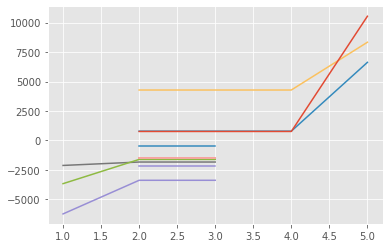

In [13]:
dfs = analysis.trial_dataframes

ax = None  # This plots everything on the same plot
for d in dfs.values():
    ax = d.episode_reward_mean.plot(ax=ax, legend=False)

In [14]:
import ray.rllib.agents.ppo as ppo

# Get checkpoint
checkpoints = analysis.get_trial_checkpoints_paths(
    trial=analysis.get_best_trial(checkpoint_metric, mode='max'),
    metric=checkpoint_metric
)
checkpoint_path = checkpoints[0][0]

env_config_validation = {
    "window_size": 14,  # The number of past samples to look at (hours)
    "reward_window_size": 7,  # And calculate reward based on the actions taken in the next n hours
    "max_allowed_loss": 1.0,  # Allow 100% loss during evaluation
    "csv_filename": valid_csv  # The variable that will be used to differentiate training and validation datasets
}

config = analysis.get_best_config(checkpoint_metric, mode='max')
config['env_config'] = env_config_validation

# Restore agent
agent = ppo.PPOTrainer(
    env="TradingEnv",
    config=config,
)

agent.restore(checkpoint_path)

2022-02-02 20:02:32,923	INFO ppo.py:167 -- In multi-agent mode, policies will be optimized sequentially by the multi-GPU optimizer. Consider setting simple_optimizer=True if this doesn't work for you.
2022-02-02 20:02:32,927	INFO trainer.py:745 -- Current log_level is ERROR. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(RolloutWorker pid=22626) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=22626)   dip[idx] = 100 * (self._dip[idx] / value)
(RolloutWorker pid=22626) /usr/local/lib/python3.7/dist-packages/ta/trend.py:774: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=22626)   din[idx] = 100 * (self._din[idx] / value)
(RolloutWorker pid=22627) /usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
(RolloutWorker pid=22627)   dip[idx] = 100 * (self._dip[idx] / value)
(Ro

In [15]:
# See how the model is wrapped by LSTM
agent.get_policy().model

FullyConnectedNetwork_as_LSTMWrapper(
  (_hidden_layers): Sequential(
    (0): SlimFC(
      (_model): Sequential(
        (0): Linear(in_features=1540, out_features=256, bias=True)
        (1): Tanh()
      )
    )
    (1): SlimFC(
      (_model): Sequential(
        (0): Linear(in_features=256, out_features=256, bias=True)
        (1): Tanh()
      )
    )
  )
  (_value_branch): SlimFC(
    (_model): Sequential(
      (0): Linear(in_features=512, out_features=1, bias=True)
    )
  )
  (lstm): LSTM(256, 512, batch_first=True)
  (_logits_branch): SlimFC(
    (_model): Sequential(
      (0): Linear(in_features=512, out_features=2, bias=True)
    )
  )
)

/usr/local/lib/python3.7/dist-packages/ta/trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
  dip[idx] = 100 * (self._dip[idx] / value)
/usr/local/lib/python3.7/dist-packages/ta/trend.py:774: RuntimeWarning: invalid value encountered in double_scalars
  din[idx] = 100 * (self._din[idx] / value)


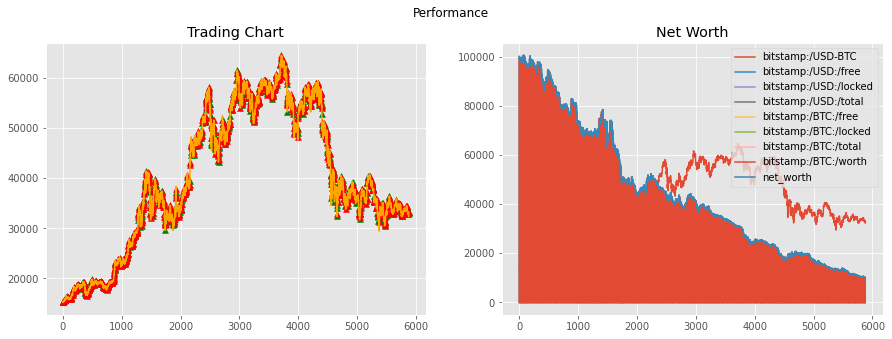

FigureWidget({
    'data': [{'name': 'Price',
              'showlegend': False,
              'type': 'candle…

In [16]:
# Instantiate the environment
env = create_env(env_config_validation)

# Run until episode ends
done = False
obs = env.reset()
# Initialize hidden_state variable that will correspond to lstm_cell_size
lstm_cell_size = config['model']['lstm_cell_size']
hidden_state = [np.zeros(lstm_cell_size), np.zeros(lstm_cell_size)]

i = 0
while not done:
    # In order for use_lstm to work we set full_fetch to True
    # This changes the output of compute action to a tuple (action, hidden_state, info)
    # We also pass in the previous hidden state in order for the model to use correctly use the LSTM
    action, hidden_state, _ = agent.compute_action(obs, state=hidden_state, full_fetch=True)
    obs, reward, done, info = env.step(action)

env.render()

In [17]:
env.observer.feed.next()

{'internal': {'bitstamp:/USD-BTC': 32584.0,
  'bitstamp:/USD:/free': 0.0,
  'bitstamp:/USD:/locked': 0.0,
  'bitstamp:/USD:/total': 0.0,
  'bitstamp:/BTC:/free': 0.30542768,
  'bitstamp:/BTC:/locked': 0.0,
  'bitstamp:/BTC:/total': 0.30542768,
  'bitstamp:/BTC:/worth': 9952.055525119998,
  'net_worth': 9952.055525119998},
 'external': {'bitstamp:/open': 32348.0,
  'bitstamp:/high': 32638.0,
  'bitstamp:/low': 32283.0,
  'bitstamp:/close': 32584.0,
  'bitstamp:/volume': 12196247,
  'bitstamp:/volume_adi': 6616180645.279606,
  'bitstamp:/volume_obv': -1348173599,
  'bitstamp:/volume_cmf': -0.21157976582337704,
  'bitstamp:/volume_fi': -1529751172.9367158,
  'bitstamp:/volume_em': -603976.780726071,
  'bitstamp:/volume_sma_em': -169556.6461951832,
  'bitstamp:/volume_vpt': -331665.5603336325,
  'bitstamp:/volume_vwap': 32865.86397725382,
  'bitstamp:/volume_mfi': 26.31460869272904,
  'bitstamp:/volume_nvi': 4444.7910556479455,
  'bitstamp:/volatility_bbm': 32974.8339835505,
  'bitstamp:/v